In [ ]:
import pandas as pd
import numpy as np

import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split, GridSearchCV, cross_val_score
from sklearn.linear_model import LinearRegression, Ridge, RidgeCV, SGDRegressor, Lasso, LassoCV
from sklearn.metrics import mean_squared_error
import seaborn as sns

from sklearn.base import BaseEstimator, TransformerMixin
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import StandardScaler
from sklearn.pipeline import make_pipeline
from sklearn.metrics import accuracy_score
from sklearn.metrics import confusion_matrix, mean_squared_error
from sklearn.metrics import classification_report
from imblearn.over_sampling import RandomOverSampler
from collections import Counter
from sklearn import preprocessing
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestRegressor


In [ ]:
# Graphics in SVG format are more sharp and legible
%config InlineBackend.figure_format = 'svg'
from google.colab import drive
drive.mount('/content/drive')
!ls "/content/drive/My Drive"
!ls "/content/drive/My Drive/Colab Notebooks"

Mounted at /content/drive
 Classroom  'Colab Notebooks'   Videos	 Папка	 проекти
 abalone.csv
 agaricus-lepiota.csv
'Copy of featuretools.ipynb'
'Copy of Trees.ipynb'
'Copy of Untitled1 (1).ipynb'
'Copy of Untitled1.ipynb'
 crx.data
 data.csv
 glass.csv
 Homework_1.ipynb
 Homework4.ipynb
 Homework5.ipynb
 HW11.ipynb
 hw5_vasiliev.ipynb
 HW6.ipynb
 HW7_1.ipynb
 HW7.ipynb
 HW9.ipynb
'hw_pandas (1).ipynb'
 hw_pandas.ipynb
'player_data (1).csv'
 player_data.csv
'Players (1).csv'
 Players.csv
'Seasons_Stats (1).csv'
 Seasons_Stats.csv
 T10Y2Y.csv
'topic2_practice_visual_titanic_solution (1).ipynb'
 topic2_practice_visual_titanic_solution.ipynb
 TreeHomework.ipynb
 Untitled0.ipynb
 Untitled2.ipynb
 winequality-red.csv
 winequality-white.csv


In [ ]:
df = pd.read_csv('/content/drive/My Drive/Colab Notebooks/abalone.csv', names=['Sex', 'Length', 'Diameter', 'Height', 'Whole_weight', 'Shucked_weight', 'Viscera_weight', 'Shell_weight', 'Rings'], sep=",")
df.head()

,Sex,Length,Diameter,Height,Whole_weight,Shucked_weight,Viscera_weight,Shell_weight,Rings
0,M,0.455,0.365,0.095,0.5140,0.2245,0.1010,0.150,15
1,M,0.350,0.265,0.090,0.2255,0.0995,0.0485,0.070,7
2,F,0.530,0.420,0.135,0.6770,0.2565,0.1415,0.210,9
3,M,0.440,0.365,0.125,0.5160,0.2155,0.1140,0.155,10
4,I,0.330,0.255,0.080,0.2050,0.0895,0.0395,0.055,7


In [ ]:
df.duplicated().sum()

0

In [ ]:
df['age'] = df.Rings + 1.5
df

,Sex,Length,Diameter,Height,Whole_weight,Shucked_weight,Viscera_weight,Shell_weight,Rings,age
0,M,0.455,0.365,0.095,0.5140,0.2245,0.1010,0.1500,15,16.5
1,M,0.350,0.265,0.090,0.2255,0.0995,0.0485,0.0700,7,8.5
2,F,0.530,0.420,0.135,0.6770,0.2565,0.1415,0.2100,9,10.5
3,M,0.440,0.365,0.125,0.5160,0.2155,0.1140,0.1550,10,11.5
4,I,0.330,0.255,0.080,0.2050,0.0895,0.0395,0.0550,7,8.5
...,...,...,...,...,...,...,...,...,...,...
4172,F,0.565,0.450,0.165,0.8870,0.3700,0.2390,0.2490,11,12.5
4173,M,0.590,0.440,0.135,0.9660,0.4390,0.2145,0.2605,10,11.5
4174,M,0.600,0.475,0.205,1.1760,0.5255,0.2875,0.3080,9,10.5
4175,F,0.625,0.485,0.150,1.0945,0.5310,0.2610,0.2960,10,11.5


In [ ]:
df.drop('Rings', axis=1, inplace=True)

In [ ]:
df.head()

,Sex,Length,Diameter,Height,Whole_weight,Shucked_weight,Viscera_weight,Shell_weight,age
0,M,0.455,0.365,0.095,0.5140,0.2245,0.1010,0.150,16.5
1,M,0.350,0.265,0.090,0.2255,0.0995,0.0485,0.070,8.5
2,F,0.530,0.420,0.135,0.6770,0.2565,0.1415,0.210,10.5
3,M,0.440,0.365,0.125,0.5160,0.2155,0.1140,0.155,11.5
4,I,0.330,0.255,0.080,0.2050,0.0895,0.0395,0.055,8.5


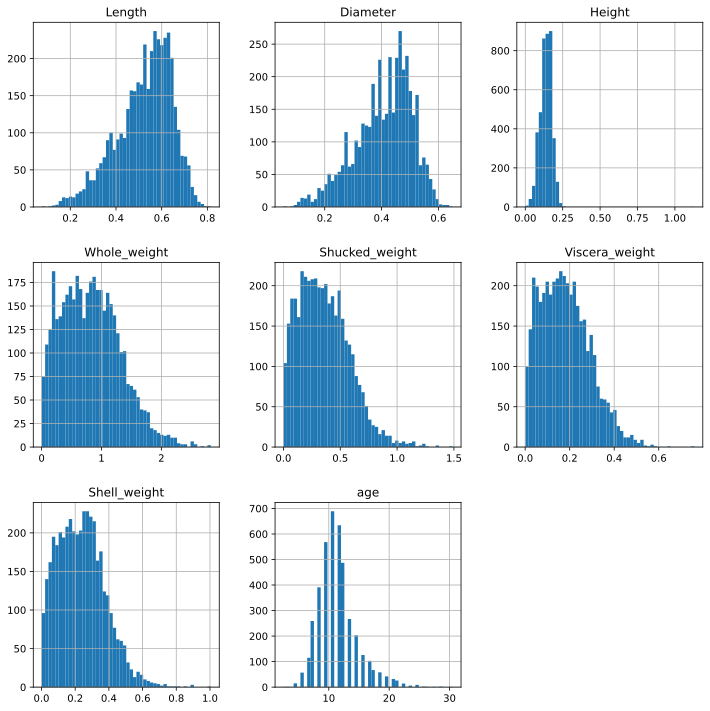

In [ ]:
df.hist(bins=50, figsize=(12, 12))
plt.show()

In [ ]:
feats = [  'Length', 'Diameter', 'Height', 'Whole_weight', 'Shucked_weight', 'Viscera_weight', 'Shell_weight','age']

In [ ]:
sns.pairplot(df[feats])

из графиков видно, что коррелируют правктически все параметры между собой
подтвердим это численно

In [ ]:
df[feats].corr()

,Length,Diameter,Height,Whole_weight,Shucked_weight,Viscera_weight,Shell_weight,age
Length,1.000000,0.986812,0.827554,0.925261,0.897914,0.903018,0.897706,0.556720
Diameter,0.986812,1.000000,0.833684,0.925452,0.893162,0.899724,0.905330,0.574660
Height,0.827554,0.833684,1.000000,0.819221,0.774972,0.798319,0.817338,0.557467
Whole_weight,0.925261,0.925452,0.819221,1.000000,0.969405,0.966375,0.955355,0.540390
Shucked_weight,0.897914,0.893162,0.774972,0.969405,1.000000,0.931961,0.882617,0.420884
Viscera_weight,0.903018,0.899724,0.798319,0.966375,0.931961,1.000000,0.907656,0.503819
Shell_weight,0.897706,0.905330,0.817338,0.955355,0.882617,0.907656,1.000000,0.627574
age,0.556720,0.574660,0.557467,0.540390,0.420884,0.503819,0.627574,1.000000


In [ ]:
new_fich = df.copy()

In [ ]:
new_fich['lh'] = new_fich['Height']/new_fich['Length']
new_fich.drop('Length', axis=1, inplace=True)
new_fich.drop('Height', axis=1, inplace=True)
new_fich['all_w'] = new_fich['Whole_weight']/(new_fich['Shucked_weight']+new_fich['Viscera_weight']+new_fich['Shell_weight'])
new_fich.drop('Shucked_weight', axis=1, inplace=True)
new_fich.drop('Viscera_weight', axis=1, inplace=True)
new_fich.drop('Shell_weight', axis=1, inplace=True)
new_fich.drop('Whole_weight', axis=1, inplace=True)


In [ ]:
new_fich.Sex = new_fich.Sex.replace({"M":1, "I":0, "F":-1})

In [ ]:
sns.pairplot(new_fich)

In [ ]:
new_fich.corr()

,Sex,Diameter,age,lh,all_w
Sex,1.000000,-0.038874,-0.034627,-0.026355,-0.022709
Diameter,-0.038874,1.000000,0.574660,0.164263,0.082925
age,-0.034627,0.574660,1.000000,0.233076,0.259600
lh,-0.026355,0.164263,0.233076,1.000000,0.066015
all_w,-0.022709,0.082925,0.259600,0.066015,1.000000


Корреляция убрана применением новых фич

In [ ]:
y = new_fich["age"].values
lab = preprocessing.LabelEncoder()
y_transformed = lab.fit_transform(y)
x = new_fich.drop(["age"], axis=1).values
x_train, x_test, y_train, y_test = train_test_split(x,y_transformed,random_state=0,test_size=0.33)
y_train


array([ 9, 10, 12, ...,  9,  8,  7])

In [ ]:
from sklearn.neighbors import KNeighborsRegressor
neigh = KNeighborsRegressor(n_neighbors=10)
neigh.fit(x_train, y_train)
KNeighborsRegressor(n_neighbors=10)
ypred = neigh.predict(x_test)
neigh.score(x_train, y_train, sample_weight=None)


0.5373469578284762

In [ ]:
neigh.score(x_test, y_test, sample_weight=None)

0.47317884680896083

In [ ]:
print("Train rmse : ", mean_squared_error(y_train, neigh.predict(x_train)))
print("Test rmse : ", mean_squared_error(y_test, ypred))

Train rmse :  4.802544674767692
Test rmse :  5.473045685279188


In [ ]:
rf_params = {'n_estimators': 200,
             'min_samples_split': 2,
             'min_samples_leaf': 4,
             'max_features': 'sqrt',
             'max_depth': None,
             'bootstrap': True}

model = RandomForestRegressor(random_state=1, **rf_params)

model.fit(x_train, y_train)

RandomForestRegressor(max_features='sqrt', min_samples_leaf=4, n_estimators=200,
                      random_state=1)

In [ ]:
y_pred = model.predict(x_test)

In [ ]:
model.score(x_test, y_test)

0.49503792005869585

In [ ]:
print("Train rmse : ", mean_squared_error(y_train, model.predict(x_train)))
print("Test rmse : ", mean_squared_error(y_test, model.predict(x_test)))

Train rmse :  3.0641033505095043
Test rmse :  5.245955892454789


Ппробовала на датасете построить модели с помощью KNeighborsRegressor и RandomForestRegressor. К сожалению, среднеквадратичные ошибки достаточно большие и скор до 0,5.